In [1]:
import torch
from typing import Union, Optional, Tuple
import os
import matplotlib.pyplot as plt


THyperparam = Union[torch.Tensor, float]


def get_path(output_dir: str, bidx: int, i: int) -> str:
    return os.path.join(output_dir, f"item_{bidx:06d}", f"frame_{i:06d}.png")

class BatchedGrayScott:
    def __init__(
        self,
        batch_size: int,
        image_size: int,  # Square images
        physical_size: float,  # dx = physical_size / image_size
        feedrate: THyperparam,
        killrate: THyperparam,
        diffusion_u: THyperparam,
        diffusion_v: THyperparam,
        scale_dt: float,
        device: str,
        output_dir: Optional[str],
        cmap: str = "jet"
    ) -> None:
        self.batch_size = batch_size
        self.image_size = image_size
        self.physical_size = physical_size
        self.feedrate = feedrate
        self.killrate = killrate
        self.diffusion_u = diffusion_u
        self.diffusion_v = diffusion_v
        self.cmap = cmap
        # Constants
        self.dx = physical_size / (image_size + 1)
        self.fu = diffusion_u / self.dx**2
        self.fv = diffusion_v / self.dx**2
        # https://github.com/cselab/gray-scott/blob/master/python/gray_scott.py
        self.dt = scale_dt * self.dx**2 / (4.0 * max(self.diffusion_u, self.diffusion_v))
        
        # Filesystem stuff
        self.device = device
        self.output_dir = output_dir
        os.makedirs(self.output_dir, exist_ok=True)
        for batch_idx in range(batch_size):
            os.makedirs(os.path.dirname(get_path(self.output_dir, batch_idx, 0)), exist_ok=True)

        # Stuff to make plot prettier
        # nodal grid (+ghosts)
        x = torch.linspace(-(physical_size / 2) - self.dx, (physical_size / 2) + self.dx, image_size + 2)
        y = torch.linspace(-(physical_size / 2) - self.dx, (physical_size / 2) + self.dx, image_size + 2)
        self.x, self.y = torch.meshgrid(x, y)


    def apply_boundary_conditions(self, x: torch.Tensor) -> torch.Tensor:
        # x: ..., H, W
        # Somehow, these are the spatial boundary conditions I've seen applied everywhere
        x[..., 0, :] = x[..., -2, :]
        x[..., :, 0] = x[..., :, -2]
        x[..., -1, :] = x[..., 1, :]
        x[..., :, -1] = x[..., :, 1]
        return x

    def laplacian(self, x: torch.Tensor) -> torch.Tensor:
        return x[..., 2:, 1:-1] + x[..., 1:-1, 2:] + x[..., 0:-2, 1:-1] + x[..., 1:-1, 0:-2] - 4 * x[..., 1:-1, 1:-1]

    def dump(self, v: torch.Tensor, i: int) -> None:
        v_np = v.detach().cpu().numpy()
        x_np = self.x.detach().cpu().numpy()
        y_np = self.y.detach().cpu().numpy()
        for bidx in range(v.shape[0]):
            fig, ax = plt.subplots(1, 1, figsize=(6, 6))
            ax.contourf(x_np, y_np, v_np[bidx, 0], levels=50, cmap=self.cmap)
            # ax.set_aspect('equal')
            ax.set_axis_off()
            fig.tight_layout()
            fig.savefig(
                get_path(self.output_dir, bidx, i),
                dpi=400,
                bbox_inches='tight',
                pad_inches = 0, 
            )
            plt.close(fig)

    def trefethen_IC(self, u: torch.Tensor, v: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Initial condition for the example used by N. Trefethen at
        https://www.chebfun.org/examples/pde/GrayScott.html
        """

        x_view = self.x[..., 1:-1, 1:-1]
        y_view = self.y[..., 1:-1, 1:-1]
        u[..., 1:-1, 1:-1] = 1 - torch.exp(-80*((x_view + 0.05)**2 + (y_view + 0.05)**2))
        v[..., 1:-1, 1:-1] = torch.exp(-80*((x_view - 0.05)**2 + (y_view - 0.05)**2))
        return (u, v)
    
    def random_init(self, u: torch.Tensor, v: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
        return (
            0.5 * (torch.ones_like(u) + torch.rand_like(u)),
            0.5 * (0.5 * torch.ones_like(v) + torch.rand_like(v)),
        )

    @torch.no_grad()
    def step(self, u: torch.Tensor, v: torch.Tensor, dt, fu, fv, feedrate, killrate, inplace: bool = True) -> Tuple[torch.Tensor, torch.Tensor]:
        if not inplace:
            u = u.detach().clone()
            v = v.detach().clone()

        # Update u, v
        u_non_boundary = u[..., 1:-1, 1:-1]
        v_non_boundary = v[..., 1:-1, 1:-1]

        uv2 = u_non_boundary * torch.pow(v_non_boundary, 2)

        u_non_boundary_delta = dt * (fu * self.laplacian(u) - uv2 + feedrate * (1 - u_non_boundary))
        v_non_boundary_delta = dt * (fv * self.laplacian(v) + uv2 - (feedrate + killrate) * v_non_boundary)
        # equiv to v += v * (f + k - (u * v)) - (4v * fv) + (v_nbrs * fv)
        u_non_boundary += u_non_boundary_delta
        v_non_boundary += v_non_boundary_delta

        u[..., 1:-1, 1:-1] = u_non_boundary
        v[..., 1:-1, 1:-1] = v_non_boundary

        u = self.apply_boundary_conditions(u)
        v = self.apply_boundary_conditions(v)
        return u, v

    @torch.no_grad()
    def integrate(self, num_steps: int, dump_freq: int, u: Optional[torch.Tensor] = None, v: Optional[torch.Tensor] = None) -> None:
        if u is None:
            assert v is None
            u = torch.zeros(self.batch_size, 1, self.image_size + 2, self.image_size + 2, device=self.device)
            v = torch.zeros_like(u)
            # u, v = self.random_init(u, v)
            u, v = self.trefethen_IC(u, v)
        else:
            assert u.shape[0] == v.shape[0]
            assert u.shape[0] == self.batch_size

        for i in range(num_steps):
            if i % dump_freq == 0:
                self.dump(v, i)
            u, v = self.step(u, v, dt=self.dt, fu=self.fu, fv=self.fv, feedrate=self.feedrate, killrate=self.killrate)

        return (u, v)

/home/haroun7/anaconda3/envs/efir/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [16]:
%%time

device = "cuda"

fs = []
ks = []
for f in [0.001 * i for i in range(0, 40, 2)]:
    for k in [0.002 * i for i in range(0, 40, 2)]:
        fs.append(f)
        ks.append(k)

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)
batch_size = len(fs)

gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=os.path.join(os.getcwd(), "outputs", "phase_study_0"),
)

nsteps = int(6000.0 / gs.dt)

u, v = gs.integrate(nsteps, nsteps - 1)

In [ ]:
data = {
    "fs": fs.detach().cpu().numpy(),
    "ks": ks.detach().cpu().numpy(),
    "u": u.detach().cpu().numpy(),
    "v": v.detach().cpu().numpy(),
}

torch.save(data, os.path.join(os.getcwd(), "outputs", "phase_study_0", "data.pt"))

In [ ]:
%%time

gs = BatchedGrayScott(
    batch_size=3,
    image_size=256,
    physical_size=2,
    feedrate=0.025,
    killrate=0.06,
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,
    device="cuda",
    output_dir=os.path.join(os.getcwd(), "outputs", "spots"),
)

nsteps = 1000.0 / gs.dt

print(int(nsteps))

_ = gs.integrate(int(nsteps), 100)

1651
CPU times: user 34.1 s, sys: 456 ms, total: 34.5 s
Wall time: 34.5 s


# Now lets look at the output states as a collage

In [ ]:
import torch
from typing import Union, Optional, Tuple
import os
import matplotlib.pyplot as plt


data = torch.load(os.path.join(os.getcwd(), "outputs", "phase_study_0", "data.pt"), map_location="cpu")

/home/haroun7/anaconda3/envs/efir/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
data["v"].shape

(400, 1, 258, 258)

In [ ]:
import torchvision

grid_img = torchvision.utils.make_grid(torch.as_tensor(data["v"]), nrow=20)
print(grid_img.shape)

torch.Size([3, 5202, 5202])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


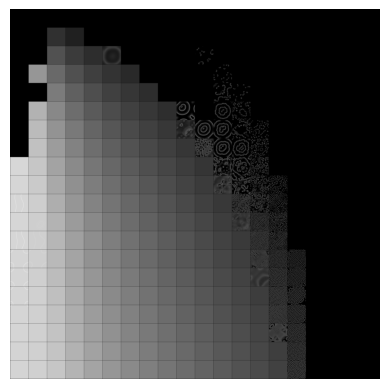

In [ ]:
plt.imshow(torch.nan_to_num(grid_img, 0.0).permute(1, 2, 0).numpy())
plt.axis("off")
plt.savefig(os.path.join(os.getcwd(), "outputs", "phase_study_0", "grid.jpg"))

In [9]:
%%time

device = "cuda"

fs = []
ks = []

for f in [0.020, 0.025, 0.03]:
    for k in [0.045, 0.06]:
        fs.append(f)
        ks.append(k)

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)
batch_size = len(fs)

gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=os.path.join(os.getcwd(), "outputs", "phase_study_2"),
    cmap="bone",
)

# nsteps = int(6000.0 / gs.dt)

nsteps = 2500
dump_freq = 10

u, v = gs.integrate(nsteps, dump_freq)

CPU times: user 8min 46s, sys: 9.06 s, total: 8min 55s
Wall time: 8min 55s


In [10]:
%matplotlib inline

import seaborn as sns
from PIL import Image

sns.set_style("dark")

nrows = 10  # timesteps
ncols = v.shape[0]
# ncols = 6
#  dump_freq = 10
reload_freq = dump_freq * 20

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10 * ncols, 10 * nrows), squeeze=False)
output_dir = os.path.join(os.getcwd(), "outputs", "phase_study_2")

for row_idx in range(nrows):
    for col_idx in range(ncols):
        img = Image.open(get_path(output_dir, bidx=col_idx, i=row_idx * reload_freq))
        ax[row_idx, col_idx].imshow(img)

        ax[row_idx, col_idx].set_axis_off()

fig.tight_layout()
plt.show()
plt.savefig(os.path.join(os.getcwd(), "outputs", "phase_study_2", "evolution.png"), bbox_inches='tight',pad_inches = 0, dpi = 400)

<Figure size 640x480 with 0 Axes>

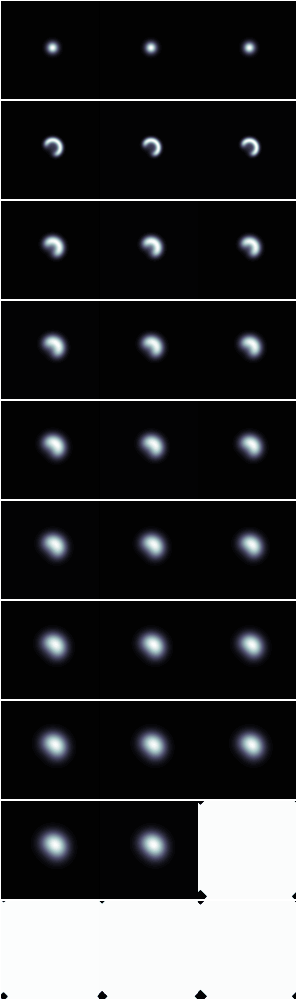

CPU times: user 4min 58s, sys: 1.59 s, total: 5min
Wall time: 4min 59s


<Figure size 640x480 with 0 Axes>

In [11]:
%%time

device = "cuda"

fs = []
ks = []

for f in [0.020, 0.025, 0.03]:
    for k in [0.075]:
        fs.append(f)
        ks.append(k)

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)
batch_size = len(fs)
output_dir = os.path.join(os.getcwd(), "outputs", "phase_study_3")
gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=output_dir,
    cmap="bone",
)

# nsteps = int(6000.0 / gs.dt)

nsteps = 2500
dump_freq = 10

u, v = gs.integrate(nsteps, dump_freq)


%matplotlib inline

import seaborn as sns
from PIL import Image

sns.set_style("dark")

nrows = 10  # timesteps
ncols = v.shape[0]
# ncols = 6
#  dump_freq = 10
reload_freq = dump_freq * 20

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10 * ncols, 10 * nrows), squeeze=False)


for row_idx in range(nrows):
    for col_idx in range(ncols):
        img = Image.open(get_path(output_dir, bidx=col_idx, i=row_idx * reload_freq))
        ax[row_idx, col_idx].imshow(img)

        ax[row_idx, col_idx].set_axis_off()

fig.tight_layout()
plt.show()
plt.savefig(os.path.join(output_dir, "evolution.png"), bbox_inches='tight',pad_inches = 0, dpi = 400)

In [4]:
%%time

device = "cuda"

fs = []
ks = []

for f in [0.020, 0.025, 0.03]:
    for k in [0.045, 0.06, 0.075]:
        fs.append(f)
        ks.append(k)

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)
batch_size = len(fs)
output_dir = os.path.join(os.getcwd(), "outputs", "phase_study_4")
gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=output_dir,
    cmap="bone",
)

# nsteps = int(6000.0 / gs.dt)

nsteps = 600
dump_freq = 10

u, v = gs.integrate(nsteps, dump_freq)


/home/haroun7/anaconda3/envs/efir/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1670525539683/work/aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


CPU times: user 2min 48s, sys: 3.3 s, total: 2min 52s
Wall time: 2min 52s


In [5]:


%matplotlib inline

import seaborn as sns
from PIL import Image

sns.set_style("dark")

nrows = 20  # timesteps
ncols = v.shape[0]
# ncols = 6
#  dump_freq = 10
reload_freq = 20

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10 * ncols, 10 * nrows), squeeze=False)


for row_idx in range(nrows):
    for col_idx in range(ncols):
        img = Image.open(get_path(output_dir, bidx=col_idx, i=200 + (row_idx * reload_freq)))
        ax[row_idx, col_idx].imshow(img)

        ax[row_idx, col_idx].set_axis_off()

fig.tight_layout()
plt.show()
plt.savefig(os.path.join(output_dir, "evolution.png"), bbox_inches='tight',pad_inches = 0, dpi = 400)

<Figure size 640x480 with 0 Axes>

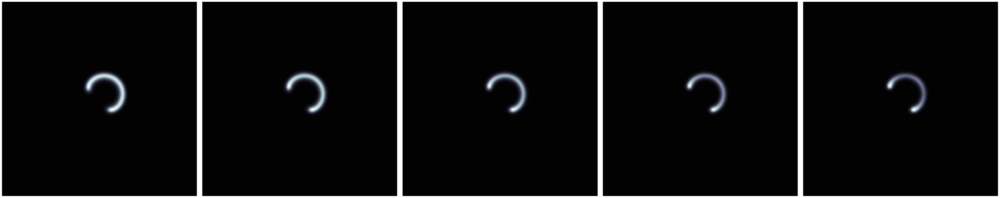

CPU times: user 10.4 s, sys: 224 ms, total: 10.6 s
Wall time: 10.5 s


<Figure size 640x480 with 0 Axes>

In [5]:
%%time
from PIL import Image
device = "cuda"

fs = []
ks = []

for f in [0.025]:
    for k in [0.06]:
        fs.append(f)
        ks.append(k)

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)
batch_size = len(fs)
output_dir = os.path.join(os.getcwd(), "outputs", "phase_study_5")
gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=output_dir,
    cmap="bone",
)

# nsteps = int(6000.0 / gs.dt)

nsteps = 300
dump_freq = 10

u, v = gs.integrate(nsteps, dump_freq)

nrows = 5  # timesteps
ncols = v.shape[0]
# ncols = 6
#  dump_freq = 10
reload_freq = 20

fig, ax = plt.subplots(nrows=ncols, ncols=nrows, figsize=(10 * nrows, 10 * ncols), squeeze=False)


for row_idx in range(nrows):
    for col_idx in range(ncols):
        img = Image.open(get_path(output_dir, bidx=col_idx, i=200 + (row_idx * reload_freq)))
        ax[col_idx, row_idx].imshow(img)

        ax[col_idx, row_idx].set_axis_off()

fig.tight_layout()
plt.show()
plt.savefig(os.path.join(output_dir, "evolution.png"), bbox_inches='tight',pad_inches = 0, dpi = 400)

In [6]:
fs = []
ks = []

# for f in [0.02, 0.025, 0.03]:
for f in [0.02]:
    for k in [0.045, 0.06, 0.075]:
        fs.append(f)
        ks.append(k)
device = "cuda"

fs = torch.tensor(fs, device=device)
ks = torch.tensor(ks, device=device)

batch_size = len(fs)


output_dir = os.path.join(os.getcwd(), "outputs", "phase_study_6")
new_gs = BatchedGrayScott(
    batch_size=batch_size,
    image_size=256,
    physical_size=2,
    feedrate=fs.view(batch_size, 1, 1, 1),
    killrate=ks.view(batch_size, 1, 1, 1),
    diffusion_u=2e-5,
    diffusion_v=1e-5,
    scale_dt=0.8,  # constant
    device=device,
    output_dir=output_dir,
    cmap="bone",
)
nsteps = 500
dump_freq = 10
u_repeated = u.repeat(batch_size, 1, 1, 1)
v_repeated = v.repeat(batch_size, 1, 1, 1)
u_new, v_new = new_gs.integrate(nsteps, dump_freq, u=u_repeated, v=v_repeated)

In [7]:
from PIL import Image
nrows = 24  # timesteps
ncols = v_new.shape[0]
# ncols = 6
#  dump_freq = 10
reload_freq = 20

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10 * ncols, 10 * nrows), squeeze=False)


for row_idx in range(nrows):
    for col_idx in range(ncols):
        img = Image.open(get_path(output_dir, bidx=col_idx, i=(row_idx * reload_freq)))
        ax[row_idx, col_idx].imshow(img)
        ax[row_idx, col_idx].set_axis_off()

fig.tight_layout()
plt.show()
plt.savefig(os.path.join(output_dir, "evolution.png"), bbox_inches='tight',pad_inches = 0, dpi = 400)

<Figure size 640x480 with 0 Axes>

In [9]:
u_non_boundary = u[..., 1:-1, 1:-1]
v_non_boundary = v[..., 1:-1, 1:-1]

uv2 = u_non_boundary * torch.pow(v_non_boundary, 2)
u_non_boundary_delta = new_gs.dt * (new_gs.fu * new_gs.laplacian(u) - uv2 + new_gs.feedrate * (1 - u_non_boundary))
v_non_boundary_delta = new_gs.dt * (new_gs.fv * new_gs.laplacian(v) + uv2 - (new_gs.feedrate + new_gs.killrate) * v_non_boundary)


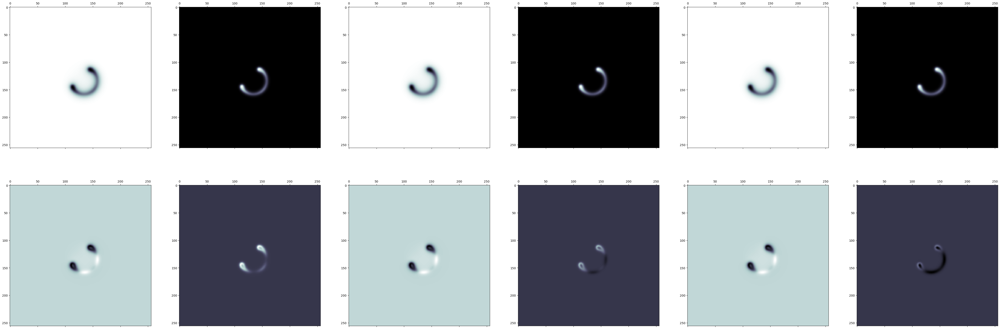

In [26]:

fig, axes = plt.subplots(nrows=2, ncols=2 * 3, figsize=(60, 20))
urange = u_non_boundary_delta.min().item(), u_non_boundary_delta.max().item()
vrange = v_non_boundary_delta.min().item(), v_non_boundary_delta.max().item()
for bidx in range(u_non_boundary_delta.shape[0]):
    axes[0, bidx * 2 + 0].matshow(u_non_boundary.detach().cpu()[0, 0], cmap="bone")
    axes[0, bidx * 2 + 1].matshow(v_non_boundary.detach().cpu()[0, 0], cmap="bone")
    axes[1, bidx * 2 + 0].matshow(u_non_boundary_delta.detach().cpu()[bidx, 0], cmap="bone", vmin=urange[0], vmax=urange[1])
    pos = axes[1, bidx * 2 + 1].matshow(v_non_boundary_delta.detach().cpu()[bidx, 0], cmap="bone", vmin=vrange[0], vmax=vrange[1])
# print(u_non_boundary[0, 0, 10, 10])
# fig.colorbar(pos, ax=axes[1, 5])
plt.show()

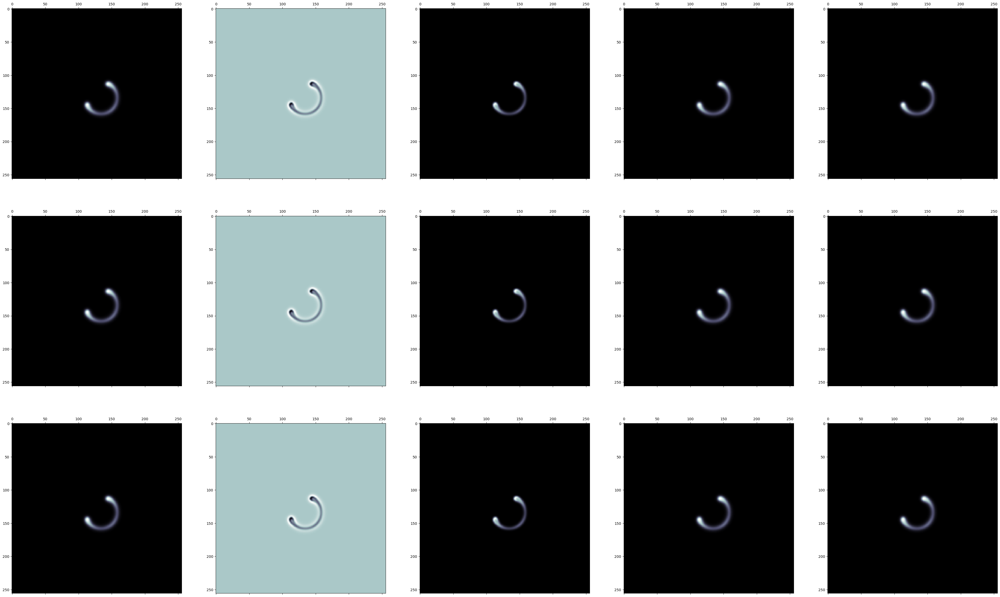

In [31]:

term1 = new_gs.dt * (new_gs.fv * new_gs.laplacian(v))
term2 = new_gs.dt * uv2
term3 = new_gs.dt * (new_gs.feedrate + new_gs.killrate) * v_non_boundary
v_non_boundary_delta = term1 + term2 + term3
nrows = term3.shape[0]

fig, axes = plt.subplots(nrows=nrows, ncols=5, figsize=(50, nrows * 10), squeeze=False)

for row_idx in range(nrows):
    axes[row_idx, 0].matshow(v_non_boundary.detach().cpu()[0, 0], cmap="bone")
    axes[row_idx, 1].matshow(term1.detach().cpu()[0, 0], cmap="bone")
    axes[row_idx, 2].matshow(term2.detach().cpu()[0, 0], cmap="bone")
    axes[row_idx, 3].matshow(term3.detach().cpu()[row_idx, 0], cmap="bone")
    axes[row_idx, 4].matshow((v_non_boundary + v_non_boundary_delta).detach().cpu()[row_idx, 0], cmap="bone")

plt.show()